# Моделирование NVT ансамбля <a class="tocSkip">

   - Система: $N = 1372$ частиц;
   - Ячейка моделирования: $V = 12.25\sigma\times12.25\sigma\times12.25\sigma$;
   - Потенциал взаимодействия: Леннард-Джонс;
   - Ансамбль: $NVT$;
   - Начальная температура: $T_i = 1.0~\varepsilon / k_B$;
   - Конечная температура: $T_f = 10^{-4}~\varepsilon / k_B$;
   - Скорости охлаждения: $\gamma = 0.001~\varepsilon / k_B\tau$;
   - Термостат: масштабирование скоростей;
   - Толщина сферического слоя (список Верле): $\Delta r_s = 0.3~\sigma $;
   - Временной шаг: $\Delta t = 0.005~\tau$;
   - Число "неравновесных" итераций: $2000000$;
   - Равновесные характеристики системы рассчитывалась через каждые $100000$ шагов;
   - Число шагов на уравновешивание системы при фиксированных внешних условиях: $M=15000$;
   - Число ансамблей $N=5000$;
   - Усреднение по ансамблям при фиксированных внешних условиях: $2N-1$ шагов (к первому ансамблю относятся шаги с $1$ по $N$ шаг, ко второму - с $2$ по $N+1$ и т. д.);
   - Функция радиального распределения вычислялась как среднее по времени за первые $N$ шагов;

## Предварительные настройки

### Импорт необходимых библиотек, классов и функций

In [1]:
from IPython import get_ipython
ipython = get_ipython()

# autoreload extension
if 'autoreload' not in ipython.extension_manager.loaded:
    %load_ext autoreload

In [2]:
from collections import Counter
from copy import deepcopy
from datetime import datetime
import os
import sys

from math import log10

In [3]:
from cycler import cycler
import matplotlib as mpl
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score, train_test_split, validation_curve
from sklearn.neighbors import KNeighborsRegressor, RadiusNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error

In [4]:
sys.path.append(os.path.dirname(sys.path[0]))

import scripts.constants as con
from scripts.plotter import Plotter, get_temperature_legend
import scripts.postprocessing as pp

%autoreload 2

In [5]:
COLORS = (
    'black',
    'red',
    'green',
    'blue',
    'cyan',
    'magenta',
    'purple',
    'orange',
    'olive',
    'yellow',
    'brown',
    'pink',
    'gray',
    'lime',
    'slateblue',
    'crimson',
    'darkviolet',
    'sienna',
    'coral',
    'navy',
    'crimson',
    'goldenrod',
    'darkcyan',
    'dodgerblue',
    'saddlebrown',
)

default_cycler = cycler(color=COLORS)

plt.rc('axes', prop_cycle=default_cycler)

print(f'{len(COLORS)} colors are acceptable.')

25 colors are acceptable.


### Пути к файлам

In [6]:
CURRENT_DATA_SLOW = '2021-06-12_cooling_slow'
PLOT_FILENAME_POSTFIX_SLOW = 'cooling_slow'

In [7]:
PATH_TO_CURRENT_DATA_SLOW = os.path.join(con.PATH_TO_DATA, CURRENT_DATA_SLOW)
PATH_TO_CURRENT_DATA_SLOW

'C:\\albert\\git_reps\\molecular_dynamics\\data\\2021-06-12_cooling_slow'

In [8]:
PATH_TO_CURRENT_PLOTS = os.path.join(con.PATH_TO_PLOTS, CURRENT_DATA_SLOW)
PATH_TO_CURRENT_PLOTS

'C:\\albert\\git_reps\\molecular_dynamics\\plots\\2021-06-12_cooling_slow'

### Пользовательские функции

In [9]:
def get_merged_data(
    old_data: pd.DataFrame,
    data_filename_prefix: str,
    merge_column_name: str,
    old_column_name: str,
    temperature: float,
    columns: list = None,
):
    df = pd.read_csv(
        f'{data_filename_prefix}{temperature:.5f}.csv',
        sep=';',
    )
    if columns is not None:
        df = df[columns]
    merged_data = old_data.merge(
        right=df,
        how='outer',
        on=merge_column_name,
    )
    merged_data = merged_data.rename(
        columns={old_column_name: f'{temperature:.5f}'})
    return merged_data

In [10]:
def save_plot(filename):
    _filename = filename
    if filename.endswith('.png'):
        _filename = _filename.removesuffix('.png')
    if filename.endswith('.eps'):
        _filename = _filename.removesuffix('.eps')
    
    plt.savefig(os.path.join(PATH_TO_CURRENT_PLOTS, f'{_filename}.png'))
    plt.savefig(os.path.join(PATH_TO_CURRENT_PLOTS, f'{_filename}.eps'))

## Параметры системы

In [11]:
setups_slow = []
rdf_slow = pp.RadialDistributionFunctionPP(path_to_data=PATH_TO_CURRENT_DATA_SLOW)

for filename in os.listdir(PATH_TO_CURRENT_DATA_SLOW)[::+1]:
    if filename.startswith('rdf') and filename.endswith('csv'):
        parts = filename[:-4].split('_')
        setup = {
            'temperature': float(parts[2]),
            'pressure': float(parts[4]) if 'P' in parts else None,
            'heating_velocity': float(parts[6]) if 'HV' in parts else None,
        }
        setups_slow.append(setup)
        print(setup)
        filename_postfix = pp.get_filename_postfix(setup)
        rdf_slow.append(filename_postfix=filename_postfix)
        rdf_slow.rename_column(column_name='rdf', setup_number=len(setups_slow) - 1)

rdf_slow.data

{'temperature': 1e-05, 'pressure': -0.36363, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.3638, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.36384, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.36404, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.36416, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.36418, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.3642, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.36425, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.36426, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.36431, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.36433, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.36455, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.45858, 'heating_velocity': 0.001}
{'temperature': 1e-05, 'pressure': -0.45877, 'heating_velocity': 0

,radius,setup_0,setup_1,setup_2,setup_3,setup_4,setup_5,setup_6,setup_7,setup_8,...,setup_73,setup_74,setup_75,setup_76,setup_77,setup_78,setup_79,setup_80,setup_81,setup_82
0,0.01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.03,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
607,6.08,0.928249,0.930377,0.930025,0.932343,0.931571,0.931532,0.931379,0.932840,0.931847,...,1.002924,1.004018,1.002552,1.002689,1.003339,1.006180,1.002352,1.001820,1.003953,1.000569
608,6.09,0.927555,0.925706,0.923937,0.922464,0.922047,0.924535,0.922592,0.919629,0.923064,...,1.001963,1.003125,1.002414,1.004005,1.004222,1.004060,1.001274,1.003524,1.004857,1.000721
609,6.10,1.038476,1.037994,1.041281,1.042005,1.041923,1.039578,1.041546,1.042990,1.039519,...,1.001820,1.005793,1.002458,1.003450,1.004989,1.003346,1.001973,1.002911,1.004392,0.999524
610,6.11,1.027572,1.027430,1.025246,1.024387,1.026374,1.025041,1.025132,1.024121,1.026131,...,1.002121,1.005550,1.002582,1.004169,1.004559,1.003266,1.004307,1.001957,1.004796,1.000953


## Функция радиального распределения $g(\textbf{r})$ при различных температурах

$$g(\textbf{r})=\dfrac{V}{N^2}\left<\sum_{i}{\sum_{j\ne i}{\delta(\textbf{r}-\textbf{r}_{ij})}}\right>$$

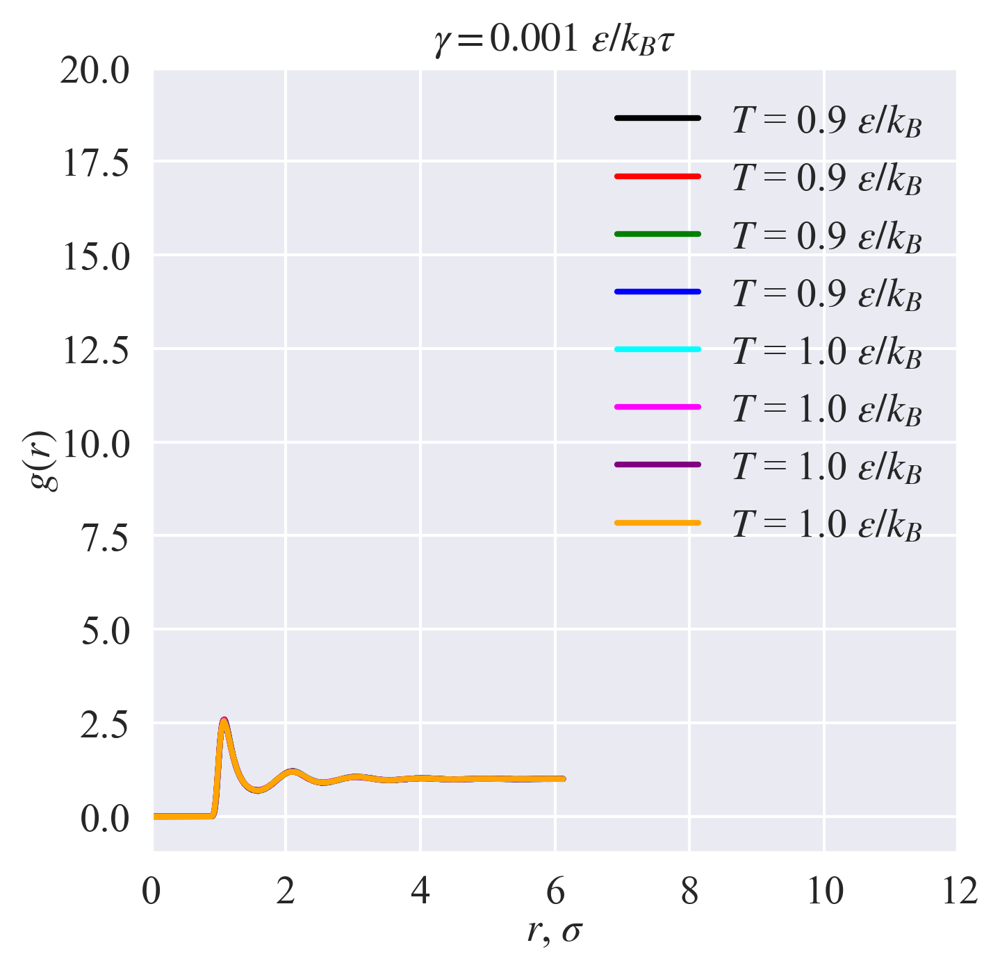

In [12]:
plotter = Plotter(
    path_to_plots=PATH_TO_CURRENT_PLOTS,
    limits=dict(
        left=0,
        right=12,
        bottom=-1,
        top=20,
    ),
    size=(5, 5),
    labels=('radius', 'rdf'),
)

shown=list(range(len(setups_slow)))[-8:]
shift = 0
for i, setup in enumerate(setups_slow):
    if shown is not None and i not in shown:
        continue
    plotter.ax.plot(
        rdf_slow.data['radius'],
        (rdf_slow.data[f'setup_{i}'] + shift * (len(setups_slow) - (i + 1))),
        label=get_temperature_legend(setup["temperature"], accuracy=1),
        color=COLORS[i - shown[0]],
    )

plotter.get_legend()
plotter.save_plot(filename=f'rdf_{PLOT_FILENAME_POSTFIX_SLOW}.png')
plotter.set_title(r'$\gamma = 0.001~\varepsilon / k_B\tau$')
plt.show()

## Таблица значений RDF

In [13]:
rdf_table = rdf_slow.get_rdf_table()
rdf_table

radius,0.01,0.02,0.03,0.04,0.05,0.06,0.07,0.08,0.09,0.10,...,6.03,6.04,6.05,6.06,6.07,6.08,6.09,6.10,6.11,6.12
setup_82,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.001781,1.000984,1.001576,1.001583,1.001951,1.000569,1.000721,0.999524,1.000953,0.999957
setup_81,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.007689,1.003542,1.003778,1.004872,1.003825,1.003953,1.004857,1.004392,1.004796,1.005893
setup_80,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.001384,1.003482,1.003989,1.001507,1.001500,1.001820,1.003524,1.002911,1.001957,1.002106
setup_79,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.005653,1.005327,1.004708,1.003294,1.004100,1.002352,1.001274,1.001973,1.004307,1.003552
setup_78,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.005149,1.005787,1.006218,1.007119,1.007711,1.006180,1.004060,1.003346,1.003266,1.001703
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
setup_4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.903036,0.887002,0.880416,0.921893,0.929147,0.931571,0.922047,1.041923,1.026374,1.048293
setup_3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.904415,0.885255,0.881185,0.920678,0.929583,0.932343,0.922464,1.042005,1.024387,1.049783
setup_2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.901887,0.888539,0.880968,0.920420,0.930122,0.930025,0.923937,1.041281,1.025246,1.049745
setup_1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.902009,0.884474,0.885382,0.917304,0.932283,0.930377,0.925706,1.037994,1.027430,1.046410


## Температура системы как признак модели

In [14]:
temperatures = np.array([
    setups_slow[value]['temperature']
    for value
    in rdf_table.index.str[6:].values.astype(np.int32)
])
samples = temperatures[:, np.newaxis]
samples

array([[9.9962e-01],
       [9.9147e-01],
       [9.7397e-01],
       [9.5924e-01],
       [9.4881e-01],
       [9.3827e-01],
       [9.2279e-01],
       [9.1250e-01],
       [9.0100e-01],
       [8.8477e-01],
       [8.7425e-01],
       [8.6189e-01],
       [8.5094e-01],
       [8.3768e-01],
       [8.2368e-01],
       [8.1549e-01],
       [8.0198e-01],
       [4.9981e-01],
       [4.8711e-01],
       [4.7396e-01],
       [4.6395e-01],
       [4.4991e-01],
       [4.3760e-01],
       [4.2660e-01],
       [4.1220e-01],
       [3.9919e-01],
       [3.8734e-01],
       [3.7505e-01],
       [3.6116e-01],
       [3.4876e-01],
       [3.3679e-01],
       [3.2454e-01],
       [3.1234e-01],
       [2.9993e-01],
       [2.9988e-01],
       [2.8760e-01],
       [2.7461e-01],
       [2.6210e-01],
       [2.5042e-01],
       [2.3857e-01],
       [2.2633e-01],
       [2.1236e-01],
       [1.9927e-01],
       [1.8729e-01],
       [1.7497e-01],
       [1.6249e-01],
       [1.4955e-01],
       [1.373

In [15]:
np.random.seed(0)
samples_indices = np.arange(samples.shape[0])
np.random.shuffle(samples_indices)
samples_train_indices = samples_indices[:samples_indices.size // 2]
samples_test_indices = samples_indices[samples_indices.size // 2:]

train_samples = samples[samples_train_indices]
test_samples = samples[samples_test_indices]

samples_train_indices, samples_test_indices

(array([30, 53, 42, 59, 22, 38,  2, 55, 26,  8, 68, 13, 71, 76, 16, 27, 45,
        57, 80, 73, 43, 60, 40, 62, 54, 82, 69,  6,  3, 78, 50,  7, 33, 72,
        48,  4, 15, 17,  5, 75, 41]),
 array([63, 34, 28, 11, 61, 23, 10, 31, 52, 66,  1, 32, 74, 14, 56, 19, 29,
        51, 49, 24, 35, 18,  0, 81, 20, 77, 25, 37, 46, 39, 65, 58, 12, 70,
        36, 21,  9, 79, 67, 64, 47, 44]))

In [16]:
train_samples, test_samples

(array([[3.3679e-01],
        [7.5200e-02],
        [1.9927e-01],
        [2.5070e-02],
        [4.3760e-01],
        [2.5042e-01],
        [9.7397e-01],
        [5.0050e-02],
        [3.8734e-01],
        [9.0100e-01],
        [1.0000e-05],
        [8.3768e-01],
        [1.0000e-05],
        [1.0000e-05],
        [8.0198e-01],
        [3.7505e-01],
        [1.6249e-01],
        [3.7630e-02],
        [1.0000e-05],
        [1.0000e-05],
        [1.8729e-01],
        [2.5050e-02],
        [2.2633e-01],
        [1.2450e-02],
        [6.2580e-02],
        [1.0000e-05],
        [1.0000e-05],
        [9.2279e-01],
        [9.5924e-01],
        [1.0000e-05],
        [9.9960e-02],
        [9.1250e-01],
        [2.9993e-01],
        [1.0000e-05],
        [1.2502e-01],
        [9.4881e-01],
        [8.1549e-01],
        [4.9981e-01],
        [9.3827e-01],
        [1.0000e-05],
        [2.1236e-01]]),
 array([[1.0000e-05],
        [2.9988e-01],
        [3.6116e-01],
        [8.6189e-01],
        

## Настройка гиперпараметров

In [17]:
regressors = {
    'linear': LinearRegression(), 
    'k_neighbors_uniform': KNeighborsRegressor(weights='uniform'), 
    'k_neighbors_distance': KNeighborsRegressor(weights='distance'), 
    'r_neighbors_uniform': RadiusNeighborsRegressor(weights='uniform'), 
    'r_neighbors_distance': RadiusNeighborsRegressor(weights='distance'), 
    'decision_tree': DecisionTreeRegressor(),
}
scores = {key: [] for key in regressors.keys()}
param_names = {
    'k_neighbors_uniform': 'n_neighbors', 
    'k_neighbors_distance': 'n_neighbors', 
    'r_neighbors_uniform': 'radius', 
    'r_neighbors_distance': 'radius',
    'decision_tree': 'max_depth',
}
param_ranges = {
    'k_neighbors_uniform': np.arange(1, 15),
    'k_neighbors_distance': np.arange(1, 15),
    'r_neighbors_uniform': np.linspace(0.4, 1.3, 10),
    'r_neighbors_distance': np.linspace(0.4, 1.3, 10),
    'decision_tree': np.arange(1, 15),
}

for i, column in enumerate(rdf_table.columns):
    print(f'Step: {i + 1} / {rdf_table.columns.shape[0]}')
    train_targets = rdf_table[column].values[samples_train_indices]
    if not train_targets.any():
        continue
    for key in list(regressors.keys())[1:]:
        _, test_scores = validation_curve(
            regressors[key],
            train_samples, train_targets,
            param_name=param_names[key],
            param_range=np.arange(1, 9),
            scoring='neg_mean_squared_error',
            cv=train_samples.shape[0],
        )
        scores[key].append(np.mean(test_scores, axis=1).argmax())

best_hyperparameters = {}
for key, value in scores.items():
    if value:
        best_hyperparameters[key] = param_ranges[key][
            Counter(value).most_common(1)[0][0]
        ]
        
best_hyperparameters

Step: 1 / 612
Step: 2 / 612
Step: 3 / 612
Step: 4 / 612
Step: 5 / 612
Step: 6 / 612
Step: 7 / 612
Step: 8 / 612
Step: 9 / 612
Step: 10 / 612
Step: 11 / 612
Step: 12 / 612
Step: 13 / 612
Step: 14 / 612
Step: 15 / 612
Step: 16 / 612
Step: 17 / 612
Step: 18 / 612
Step: 19 / 612
Step: 20 / 612
Step: 21 / 612
Step: 22 / 612
Step: 23 / 612
Step: 24 / 612
Step: 25 / 612
Step: 26 / 612
Step: 27 / 612
Step: 28 / 612
Step: 29 / 612
Step: 30 / 612
Step: 31 / 612
Step: 32 / 612
Step: 33 / 612
Step: 34 / 612
Step: 35 / 612
Step: 36 / 612
Step: 37 / 612
Step: 38 / 612
Step: 39 / 612
Step: 40 / 612
Step: 41 / 612
Step: 42 / 612
Step: 43 / 612
Step: 44 / 612
Step: 45 / 612
Step: 46 / 612
Step: 47 / 612
Step: 48 / 612
Step: 49 / 612
Step: 50 / 612
Step: 51 / 612
Step: 52 / 612
Step: 53 / 612
Step: 54 / 612
Step: 55 / 612
Step: 56 / 612
Step: 57 / 612
Step: 58 / 612
Step: 59 / 612
Step: 60 / 612
Step: 61 / 612
Step: 62 / 612
Step: 63 / 612
Step: 64 / 612
Step: 65 / 612
Step: 66 / 612
Step: 67 / 612
Step

Step: 520 / 612
Step: 521 / 612
Step: 522 / 612
Step: 523 / 612
Step: 524 / 612
Step: 525 / 612
Step: 526 / 612
Step: 527 / 612
Step: 528 / 612
Step: 529 / 612
Step: 530 / 612
Step: 531 / 612
Step: 532 / 612
Step: 533 / 612
Step: 534 / 612
Step: 535 / 612
Step: 536 / 612
Step: 537 / 612
Step: 538 / 612
Step: 539 / 612
Step: 540 / 612
Step: 541 / 612
Step: 542 / 612
Step: 543 / 612
Step: 544 / 612
Step: 545 / 612
Step: 546 / 612
Step: 547 / 612
Step: 548 / 612
Step: 549 / 612
Step: 550 / 612
Step: 551 / 612
Step: 552 / 612
Step: 553 / 612
Step: 554 / 612
Step: 555 / 612
Step: 556 / 612
Step: 557 / 612
Step: 558 / 612
Step: 559 / 612
Step: 560 / 612
Step: 561 / 612
Step: 562 / 612
Step: 563 / 612
Step: 564 / 612
Step: 565 / 612
Step: 566 / 612
Step: 567 / 612
Step: 568 / 612
Step: 569 / 612
Step: 570 / 612
Step: 571 / 612
Step: 572 / 612
Step: 573 / 612
Step: 574 / 612
Step: 575 / 612
Step: 576 / 612
Step: 577 / 612
Step: 578 / 612
Step: 579 / 612
Step: 580 / 612
Step: 581 / 612
Step: 58

{'k_neighbors_uniform': 5,
 'k_neighbors_distance': 5,
 'r_neighbors_uniform': 0.4,
 'r_neighbors_distance': 0.4,
 'decision_tree': 2}

## Обучение модели

In [19]:
regressors_list = []
scores_dict = {
    'linear': [],
    'k_neighbors_uniform': [],
    'k_neighbors_distance': [],
    'r_neighbors_uniform': [],
    'r_neighbors_distance': [],
    'decision_tree': [],
}

for i, column in enumerate(rdf_table.columns):
    print(f'Step: {i + 1} / {rdf_table.columns.shape[0]}')
    train_targets = rdf_table[column].values[samples_train_indices]
    regressors = {
        'linear': LinearRegression(),
        'k_neighbors_uniform': KNeighborsRegressor(n_neighbors=5, weights='uniform'),
        'k_neighbors_distance': KNeighborsRegressor(n_neighbors=5, weights='distance'),
        'r_neighbors_uniform': RadiusNeighborsRegressor(radius=0.4, weights='uniform'),
        'r_neighbors_distance': RadiusNeighborsRegressor(radius=0.4, weights='distance'),
        'decision_tree': DecisionTreeRegressor(max_depth=2,),
    }
    for key, value in regressors.items():
        score = cross_val_score(
            value, 
            train_samples, train_targets,
            scoring='neg_mean_squared_error',
            cv=train_samples.shape[0],
        ).mean()
        scores_dict[key].append(score)
        regressors[key].fit(train_samples, train_targets)
    regressors_list.append(regressors)

for key, value in scores_dict.items():
    scores_dict[key] = np.array(value)

Step: 1 / 612
Step: 2 / 612
Step: 3 / 612
Step: 4 / 612
Step: 5 / 612
Step: 6 / 612
Step: 7 / 612
Step: 8 / 612
Step: 9 / 612
Step: 10 / 612
Step: 11 / 612
Step: 12 / 612
Step: 13 / 612
Step: 14 / 612
Step: 15 / 612
Step: 16 / 612
Step: 17 / 612
Step: 18 / 612
Step: 19 / 612
Step: 20 / 612
Step: 21 / 612
Step: 22 / 612
Step: 23 / 612
Step: 24 / 612
Step: 25 / 612
Step: 26 / 612
Step: 27 / 612
Step: 28 / 612
Step: 29 / 612
Step: 30 / 612
Step: 31 / 612
Step: 32 / 612
Step: 33 / 612
Step: 34 / 612
Step: 35 / 612
Step: 36 / 612
Step: 37 / 612
Step: 38 / 612
Step: 39 / 612
Step: 40 / 612
Step: 41 / 612
Step: 42 / 612
Step: 43 / 612
Step: 44 / 612
Step: 45 / 612
Step: 46 / 612
Step: 47 / 612
Step: 48 / 612
Step: 49 / 612
Step: 50 / 612
Step: 51 / 612
Step: 52 / 612
Step: 53 / 612
Step: 54 / 612
Step: 55 / 612
Step: 56 / 612
Step: 57 / 612
Step: 58 / 612
Step: 59 / 612
Step: 60 / 612
Step: 61 / 612
Step: 62 / 612
Step: 63 / 612
Step: 64 / 612
Step: 65 / 612
Step: 66 / 612
Step: 67 / 612
Step

Step: 520 / 612
Step: 521 / 612
Step: 522 / 612
Step: 523 / 612
Step: 524 / 612
Step: 525 / 612
Step: 526 / 612
Step: 527 / 612
Step: 528 / 612
Step: 529 / 612
Step: 530 / 612
Step: 531 / 612
Step: 532 / 612
Step: 533 / 612
Step: 534 / 612
Step: 535 / 612
Step: 536 / 612
Step: 537 / 612
Step: 538 / 612
Step: 539 / 612
Step: 540 / 612
Step: 541 / 612
Step: 542 / 612
Step: 543 / 612
Step: 544 / 612
Step: 545 / 612
Step: 546 / 612
Step: 547 / 612
Step: 548 / 612
Step: 549 / 612
Step: 550 / 612
Step: 551 / 612
Step: 552 / 612
Step: 553 / 612
Step: 554 / 612
Step: 555 / 612
Step: 556 / 612
Step: 557 / 612
Step: 558 / 612
Step: 559 / 612
Step: 560 / 612
Step: 561 / 612
Step: 562 / 612
Step: 563 / 612
Step: 564 / 612
Step: 565 / 612
Step: 566 / 612
Step: 567 / 612
Step: 568 / 612
Step: 569 / 612
Step: 570 / 612
Step: 571 / 612
Step: 572 / 612
Step: 573 / 612
Step: 574 / 612
Step: 575 / 612
Step: 576 / 612
Step: 577 / 612
Step: 578 / 612
Step: 579 / 612
Step: 580 / 612
Step: 581 / 612
Step: 58

## Визуализация ошибок

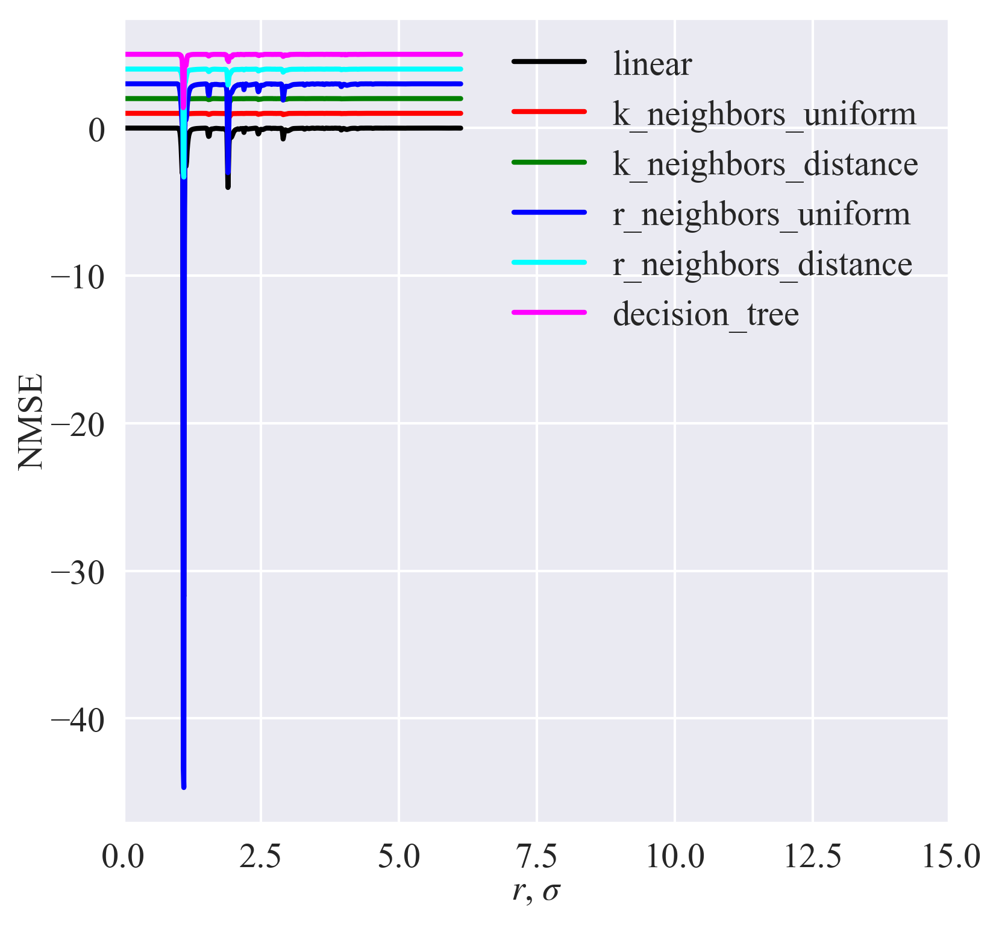

In [20]:
i = 0
for key, value in scores_dict.items():
    plt.plot(
        rdf_slow.data['radius'],
        value + i, label=key, 
        color=COLORS[i],
    )
    i += 1
plt.legend()
plt.xlim(
    left=0.0,
    right=15,
)
plt.ylim(
    #     top=0.01,
    #     bottom=-0.25,
)
plt.xlabel(r'$r$, $\sigma $')
plt.ylabel('NMSE')
save_plot('mse_after_cv')

In [21]:
predicted_temperatures = np.array(test_samples)

predicted_rdf_points = {
    regressor: {key: [] for key in predicted_temperatures[:, 0]}
    for regressor in scores_dict.keys()
}

for item in regressors_list:
    for key, value in item.items():
        predicted_data = value.predict(predicted_temperatures)
        for _key, _ in predicted_rdf_points[key].items():
            predicted_rdf_points[key][_key].append(
                predicted_data[np.where(predicted_temperatures[:, 0] == _key)][0]
            )

for key, value in predicted_rdf_points.items():
    for _key, _value in value.items():
        predicted_rdf_points[key][_key] = np.array(_value)

In [22]:
for i, temperature in zip(samples_test_indices, predicted_temperatures):
    print(i, temperature[0])

63 1e-05
34 0.29988
28 0.36116
11 0.86189
61 0.01247
23 0.4266
10 0.87425
31 0.32454
52 0.08749
66 1e-05
1 0.99147
32 0.31234
74 1e-05
14 0.82368
56 0.04998
19 0.47396
29 0.34876
51 0.09972
49 0.11212
24 0.4122
35 0.2876
18 0.48711
0 0.99962
81 1e-05
20 0.46395
77 1e-05
25 0.39919
37 0.2621
46 0.14955
39 0.23857
65 1e-05
58 0.03741
12 0.85094
70 1e-05
36 0.27461
21 0.44991
9 0.88477
79 1e-05
67 1e-05
64 1e-05
47 0.13737
44 0.17497


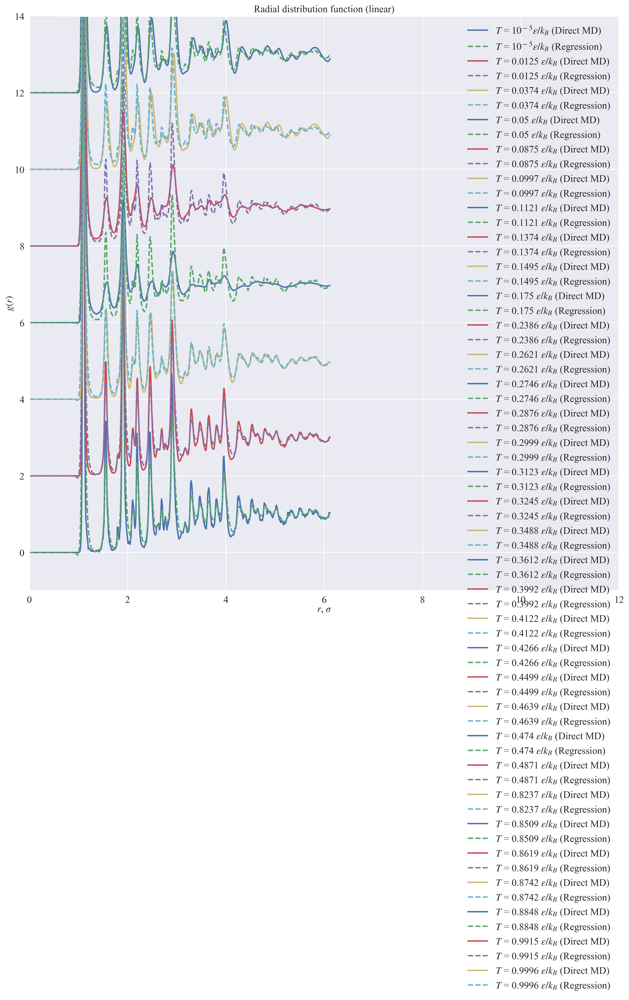

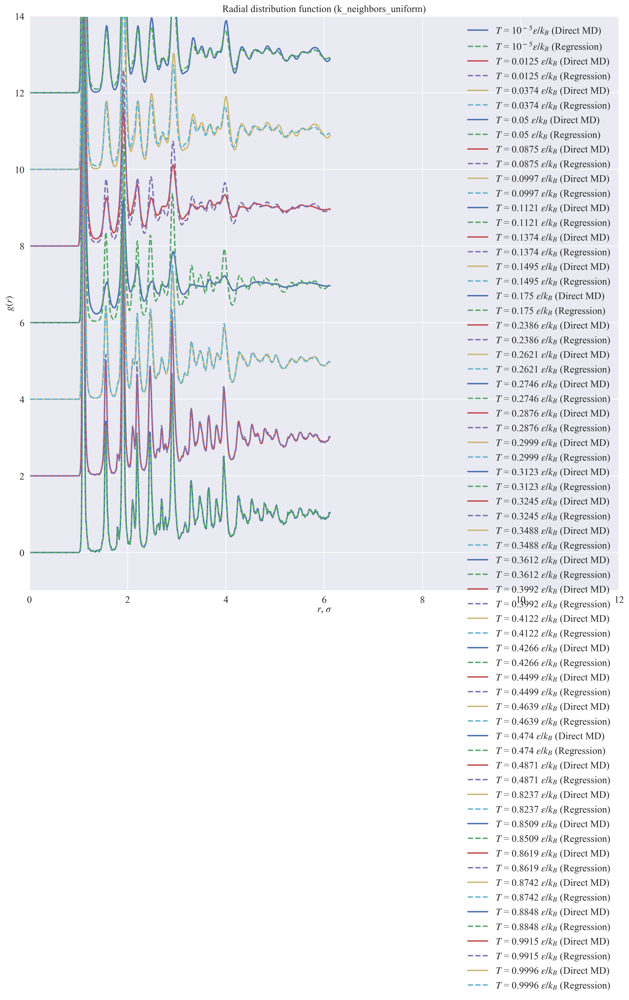

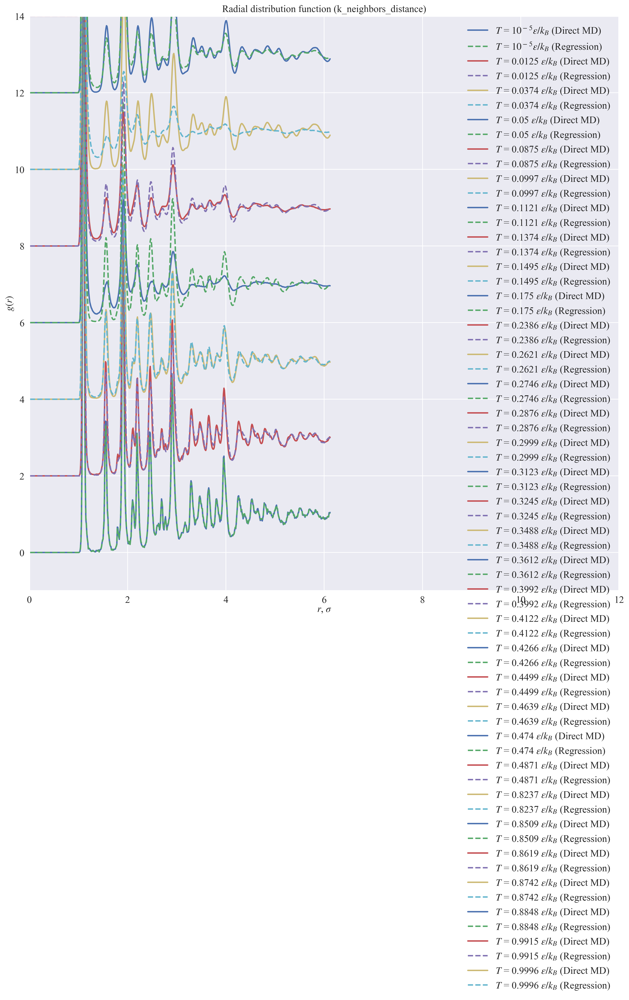

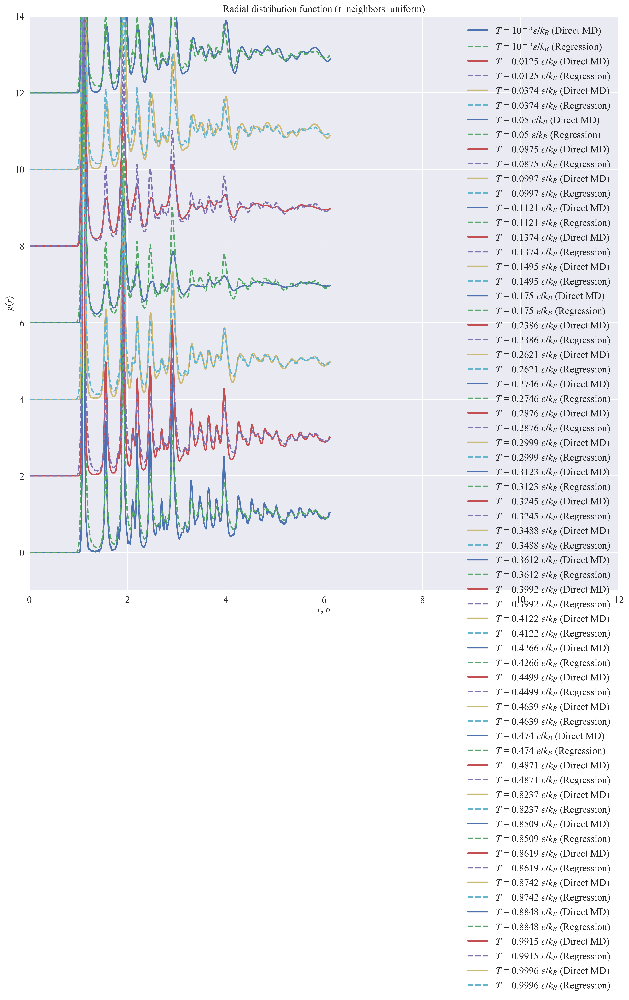

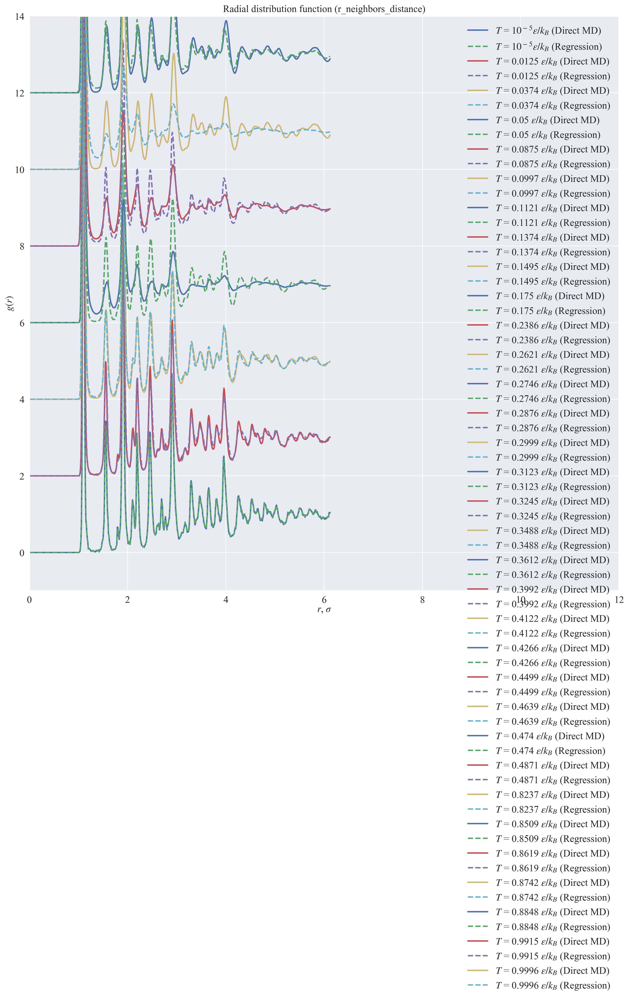

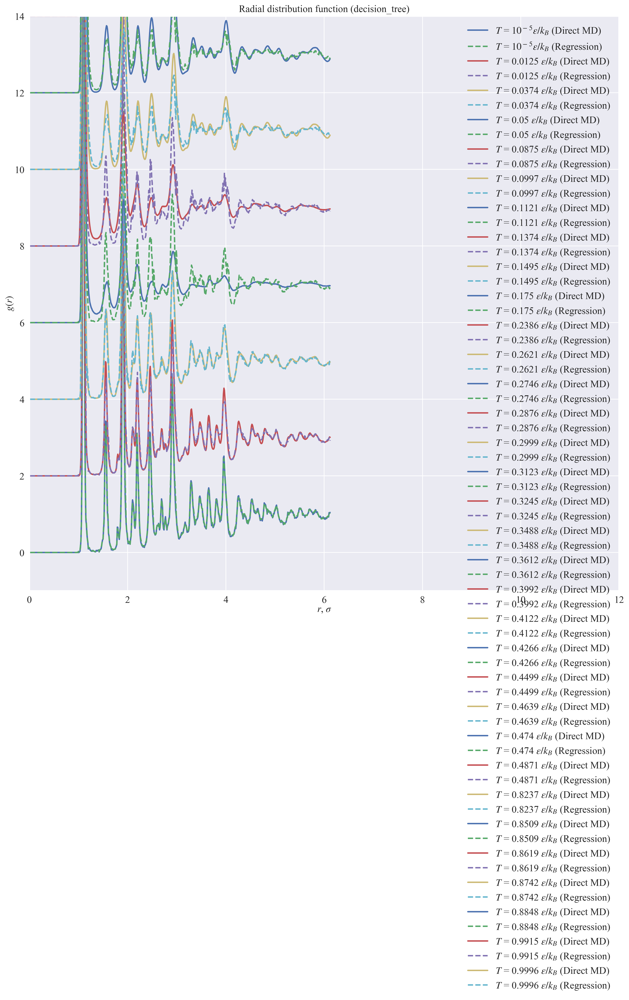

In [23]:
for key, value in predicted_rdf_points.items():
    plotter = Plotter(
        path_to_plots=PATH_TO_CURRENT_PLOTS,
        limits=dict(
            left=0,
            right=12,
            bottom=-1,
            top=14,
        ),
        size=(15, 15),
        labels=('radius', 'rdf'),
    )
    plotter.ax.set_title(f'Radial distribution function ({key})')
    shown_temperatures = []
    for i, setup in enumerate(setups_slow):
        temperature = setup["temperature"]
        if temperature not in predicted_temperatures:
            continue
        if round(temperature, 4) in shown_temperatures:
            continue
        else:
            shift_scale = 2
            plotter.ax.plot(
                rdf_slow.data['radius'],
                rdf_slow.data[f'setup_{i}'] + shift_scale * len(shown_temperatures),
                label=get_temperature_legend(temperature, 4) + ' (Direct MD)',
            )
            plotter.ax.plot(
                rdf_table.columns.values,
                value[temperature] + shift_scale * len(shown_temperatures),
                '--',
                label=get_temperature_legend(temperature, 4) + ' (Regression)',
            )
            shown_temperatures.append(round(temperature, 4))

    plotter.ax.legend()
    plotter.save_plot(f'rdf_with_predicted_cooling_{key}.png')
    plt.show()

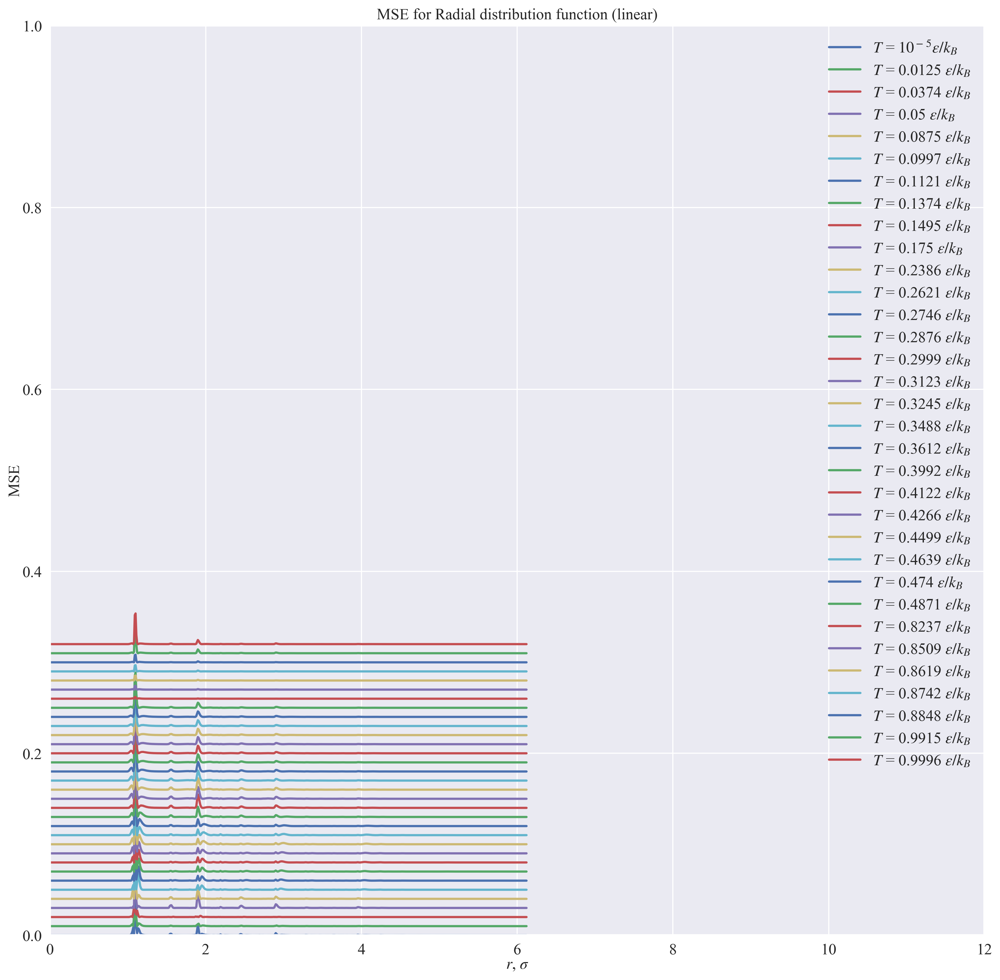

<Figure size 1771.65x1771.65 with 0 Axes>

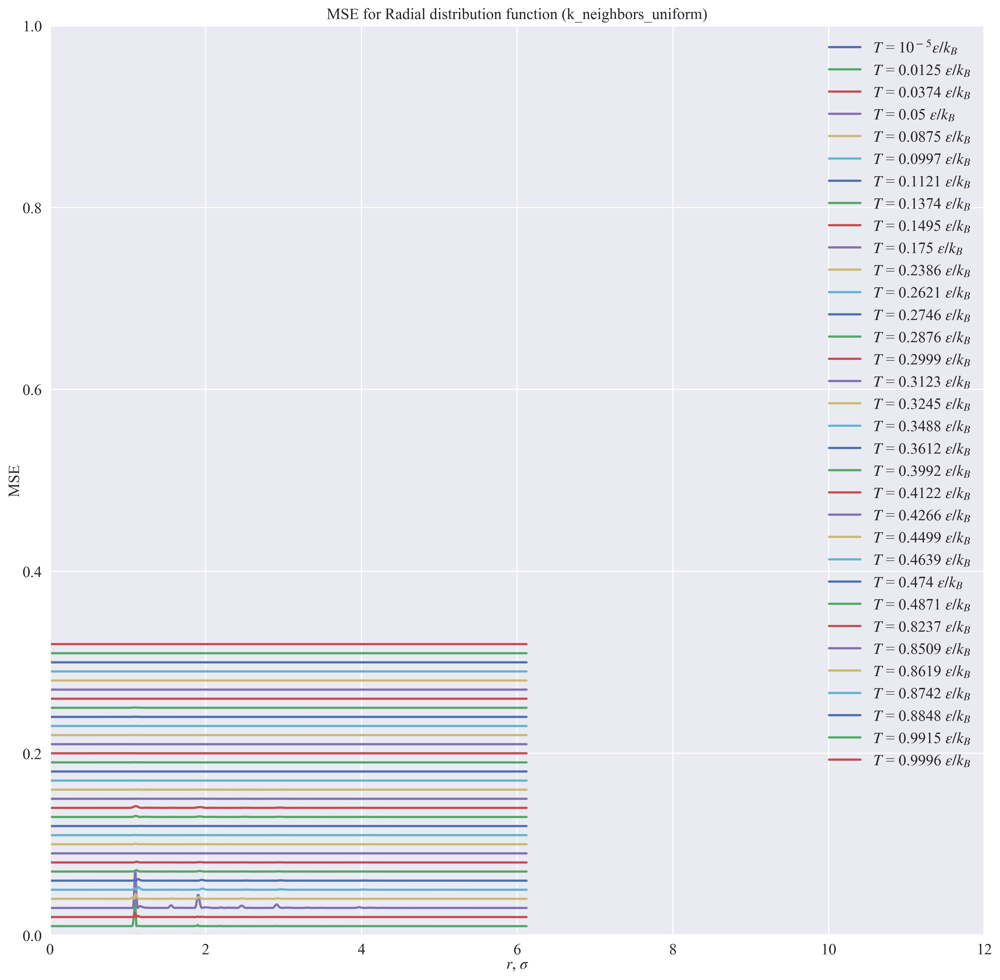

<Figure size 1771.65x1771.65 with 0 Axes>

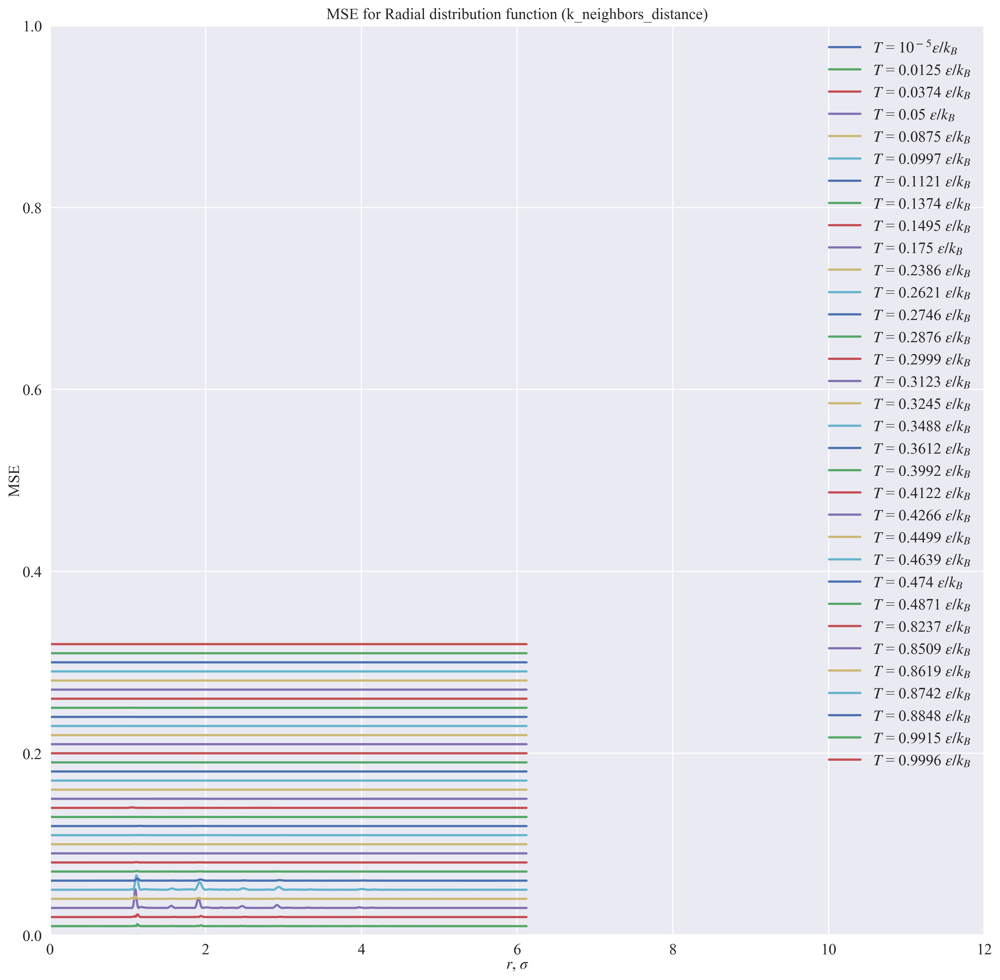

<Figure size 1771.65x1771.65 with 0 Axes>

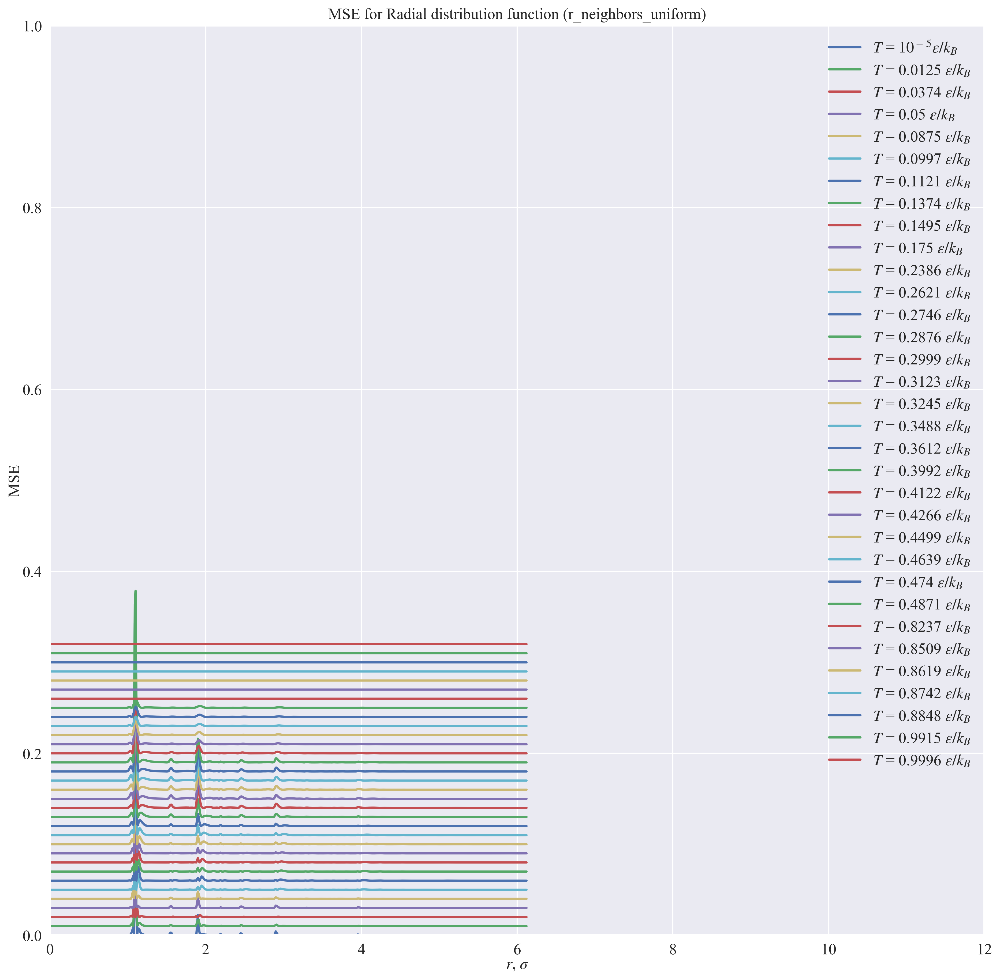

<Figure size 1771.65x1771.65 with 0 Axes>

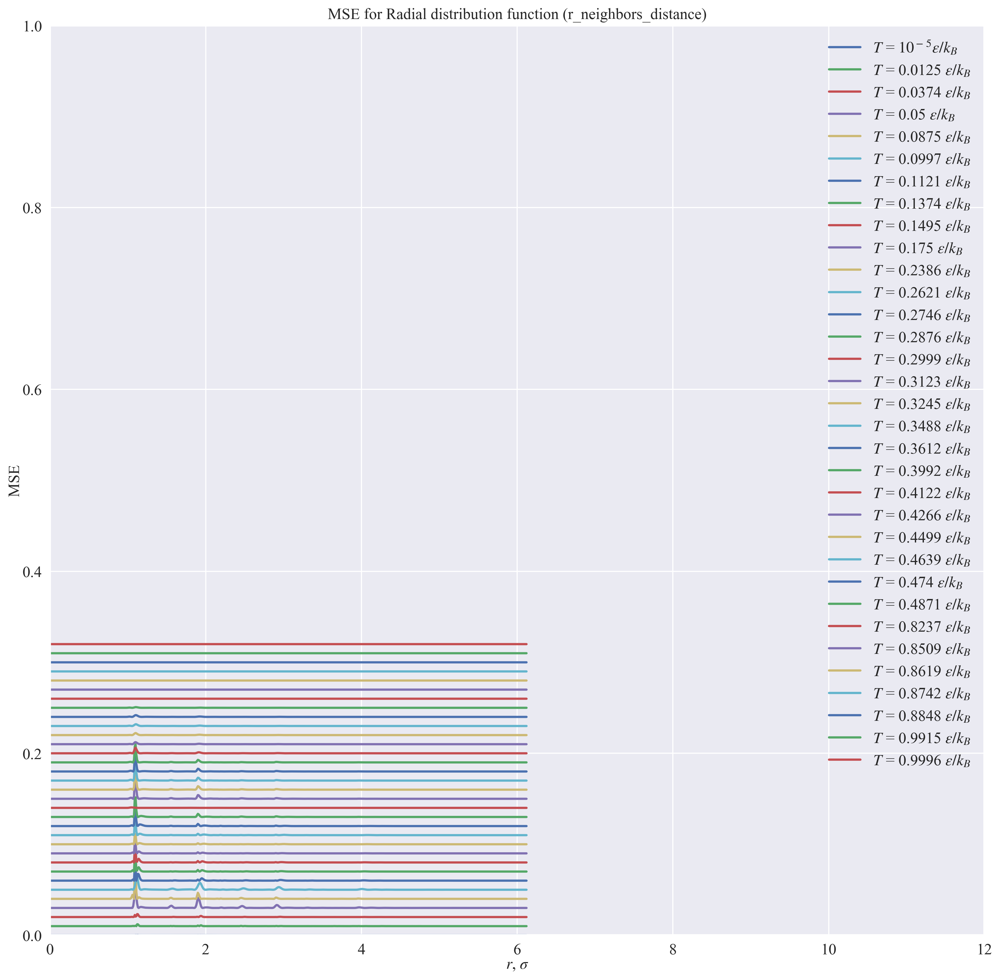

<Figure size 1771.65x1771.65 with 0 Axes>

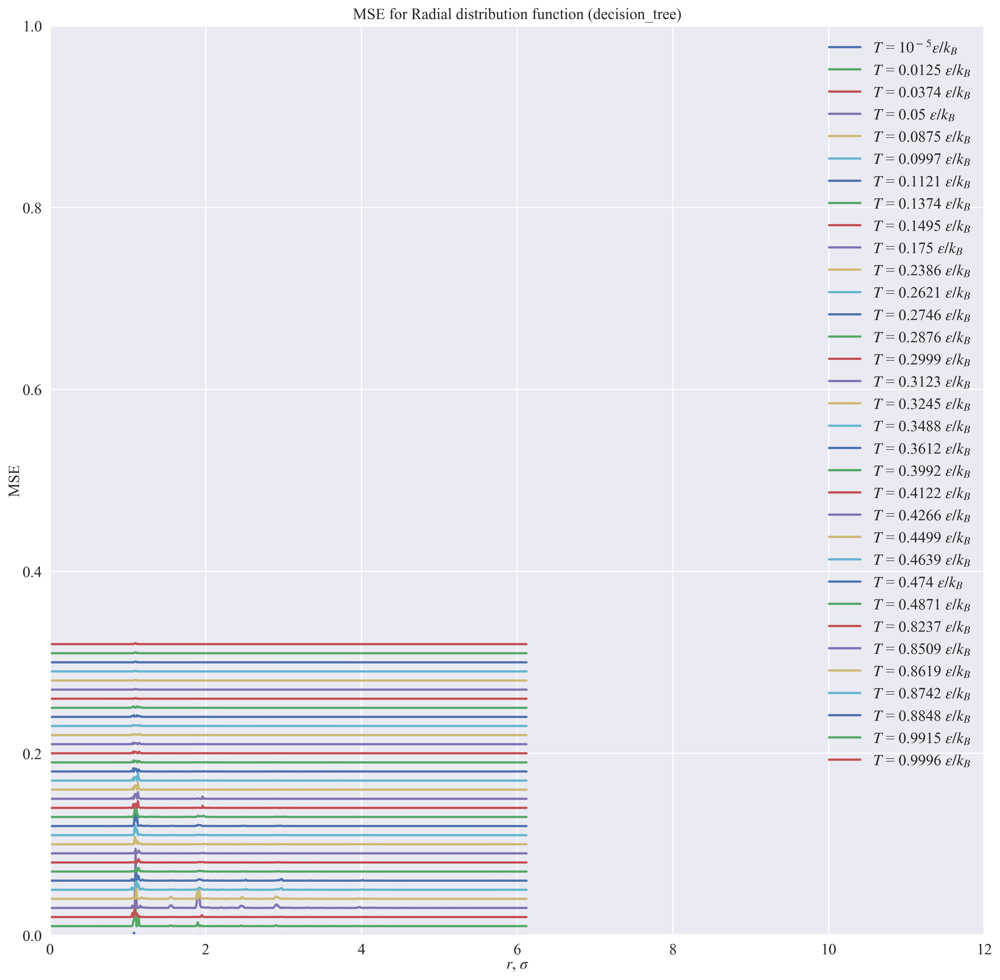

<Figure size 1771.65x1771.65 with 0 Axes>

In [24]:
max_mse = {
    'names': [],
}

for key, value in predicted_rdf_points.items():
    name = ''.join([item[0].upper() for item in key.split('_')])
    max_mse['names'].append(name)
    
    plotter = Plotter(
        path_to_plots=PATH_TO_CURRENT_PLOTS,
        limits=dict(
            left=0,
            right=12,
#             bottom=-1,
#             top=14,
        ),
        size=(15, 15),
        labels=('radius', 'MSE'),
    )
    plotter.ax.set_title(f'MSE for Radial distribution function ({key})')
    
    shown_temperatures = []
    for i, setup in enumerate(setups_slow):
        temperature = setup["temperature"]
        if temperature not in predicted_temperatures:
            continue
        if round(temperature, 4) in shown_temperatures:
            continue
        else:
            mse = (
                value[temperature]
                - rdf_slow.data[f'setup_{i}']
            ) ** 2 / rdf_table.columns.values.size
            try:
                max_mse[temperature].append(mse.max())
            except KeyError:
                max_mse[temperature] = [mse.max()]
            plotter.ax.plot(
                rdf_table.columns.values,
                mse + 0.01 * len(shown_temperatures),
                label=get_temperature_legend(temperature, 4),
            )
            shown_temperatures.append(round(temperature, 4))

    plotter.ax.legend()
    plotter.save_plot(f'rdf_mse_cooling_{key}.png')
    plt.show()
    save_plot(f'rdf_mse_cooling_{key}.png')
    plt.show()

In [25]:
max_mse['names']

['L', 'KNU', 'KND', 'RNU', 'RND', 'DT']

IndexError: tuple index out of range

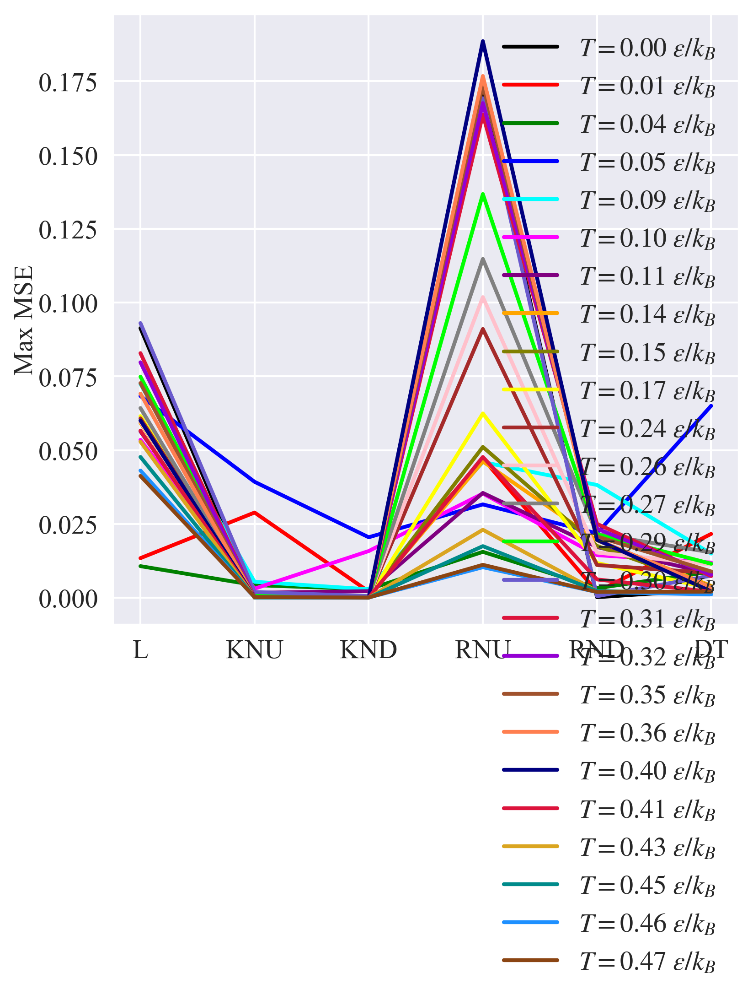

In [26]:
fig, ax = plt.subplots()
i = 0
for temperature, values in max_mse.items():
    if isinstance(temperature, float):
        x = list(range(len(values)))
        ax.plot(x, values, label=fr'$T = {temperature:.2f}~\epsilon / k_B$', color=COLORS[i])
        i += 1
        ax.set_xticks(x)
        ax.set_xticklabels(max_mse['names'])
        ax.set_ylabel('Max MSE')
        ax.legend()
        save_plot(f'max_mse.png')